<mark> <font size="3"> Suman Pan - 218352 </mark>


<mark> <font size="3"> Clara Llòria - 218147 </mark>

# Lab 2. Robust homography estimation: building image mosaics

In this practical session, we will create panoramic images by stitching multiple images of a scene taken from the same position, but pointing the camera to slightly different directions.  These images are related by homographies that we will need to compute.  The process will have the following steps:

- The first step will be to compute keypoints in the images that we can use to find correspondences.  We will use SIFT or ORB keypoints and features.
- Next we will compute correspondences between sets of keypoint features. We will use existing code for these first two steps.
- From the correspondences we will compute the homography that maps one image into the another. Since some correspondences may be erroneous, the computation will have to be robust to outliers. We will use the "RANdom SAmple Consensus" (RANSAC) method that you will have to complete.
- Finally, with the homographies computed, we will map all the images into a common canvas by using a variant of the  `apply_H` function from the last assignment.

Finally, you will have to answer the questions and complete the provided code when necessary as required. Some questions are rather theoretical and eventually imply some calculations while others are practical questions. **You must deliver the completed (and executed) ipynb file and a pdf file with the answers to the questions (included the parts of the code that need to be added).**

In [61]:
# ! pip install plotly

In [62]:
import numpy as np
import cv2
import random
import math
import sys
import matplotlib
from matplotlib import pyplot as plt
from operator import itemgetter
from utils import apply_H_fixed_image_size, Normalization, DLT_homography
import os

In [63]:
# !pip install opencv-contrib-python==4.4.0.46

## **1. Compute image correspondences**

The first step is to read the images and to compute their keypoints. The images are RGB. We have to convert them to gray scale with values in order to compute the keypoints on them. Then, we compute the keypoints and descriptors of every image. For the parts where the content of the two images coincide, you can visually check that many of the detected points are detected in both images. We want to find these _correspondences_.

In [64]:
# Function to switch over ORB and SIFT methods and run just the code related to them
def get_method(type_num):
    switcher = {
        0: "ORB",
        1: "SIFT",
    }
    return switcher.get(type_num, "nothing")

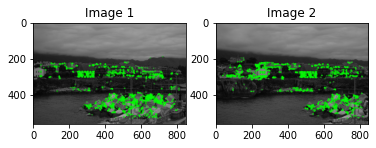

In [65]:
img1 = cv2.imread('Data/Llanes/llanes_a.jpg',cv2.IMREAD_GRAYSCALE)
img2 = cv2.imread('Data/Llanes/llanes_b.jpg',cv2.IMREAD_GRAYSCALE)
img3 = cv2.imread('Data/Llanes/llanes_c.jpg',cv2.IMREAD_GRAYSCALE)

# Initiate ORB detector
orb = cv2.ORB_create(3000)
# find the keypoints and descriptors with ORB
kp1, des1 = orb.detectAndCompute(img1,None)
kp2, des2 = orb.detectAndCompute(img2,None)

# draw only keypoints location,not size and orientation
img1b = cv2.drawKeypoints(img1, kp1, None, color=(0,255,0), flags=0)
img2b = cv2.drawKeypoints(img2, kp2, None, color=(0,255,0), flags=0)

# Plot
fig, (ax1, ax2) = plt.subplots(1, 2)
ax1.set_title('Image 1')
ax2.set_title('Image 2')
ax1.imshow(img1b); ax2.imshow(img2b)
plt.show()

# Add a flag to run only the ORB or SIFT method and avoid errors
flag_method = get_method(1)

**Q1.** Are the keypoints uniformly distributed over the image? Where are there more keypoints? Why?

<mark> <font size="3"> **Answer:** </mark>

The keypoints found are not uniformly distributed over the image, but we can find them at the areas where the gradients on the same image are greater, that is, those zones where the changes in the edges are more noticeable since these areas will provide more distinguishable information to find the correspondences compared to more uniform areas.

To match the keypoints between two images, we need to assign to each keypoint in the first image the one that has the most similar descriptor in the second image. 

Execute the following code to find image correspondences using ORB [1] (you may also use SIFT [2], SURF [3], etc, an example of the use of SIFT is given in another code cell below).

[1] Ethan Rublee, Vincent Rabaud, Kurt Konolige, Gary R. Bradski. ORB: An efficient alternative to SIFT or SURF. ICCV, 2564-2571, 2011.

[2] David Lowe. Object recognition from local scale-invariant features. ICCV, 1150-1157, 1999.

[3] Herbert Bay, Tinne Tuytelaars, Luc Van Gool. Surf: Speeded up robust features. ECCV, 404-417, 2006.

<mark><font size="3"> **ORB:** </mark>

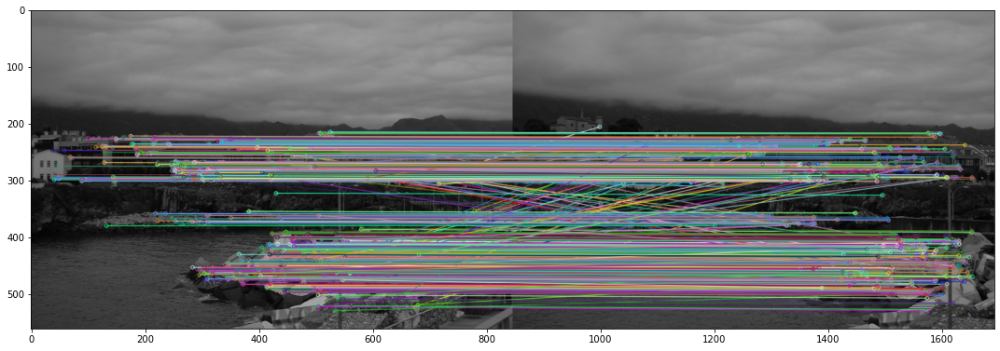

In [66]:
# Keypoint matching

# OBR method
bf = cv2.BFMatcher()
    
matches_12 = bf.knnMatch(des1,des2,k=2)
# Apply ratio test
good_matches_12 = []
for m,n in matches_12:

    if m.distance < 0.85*n.distance:
        good_matches_12.append([m])

# Show "good" matches 
img_12 = cv2.drawMatchesKnn(img1,kp1,img2,kp2,good_matches_12,None,flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)
plt.imshow(img_12)
fig = matplotlib.pyplot.gcf()
fig.set_size_inches(18.5, 10.5)
plt.show()

In case you want to find SIFT correspondences you may use the code below. 

NOTE: SIFT is not available in certain OpenCV versions. A version that worked for us was opencv-contrib 4.4.0.46, you can install it with the following command: `pip install opencv-contrib-python==4.4.0.46`

<mark><font size="3"> **SIFT:** </mark>

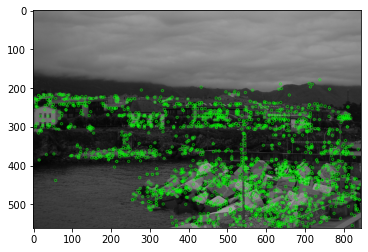

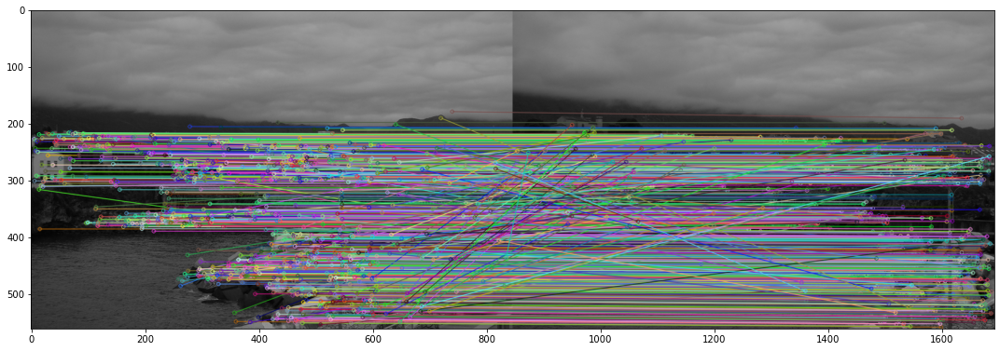

In [67]:
# Initiate SIFT detector

# Run only if we are in SIFT method
if flag_method != "ORB":

    sift = cv2.SIFT_create(3000)

    # find the keypoints and descriptors
    kp1, des1 = sift.detectAndCompute(img1,None)
    kp2, des2 = sift.detectAndCompute(img2,None)

    # draw only keypoints location,not size and orientation
    img1b = cv2.drawKeypoints(img1, kp1, None, color=(0,255,0), flags=0)
    plt.imshow(img1b), plt.show()

    # Keypoint matching
    bf = cv2.BFMatcher(cv2.NORM_L2, crossCheck=True)
    matches_12 = bf.match(des1,des2)

    # Show matches
    img_12 = cv2.drawMatches(img1,kp1,img2,kp2,matches_12,None,flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)
    plt.imshow(img_12)
    fig = matplotlib.pyplot.gcf()
    fig.set_size_inches(18.5, 10.5)
    plt.show()

**Q2.**
Compute and visualize the matchings between image 2 and 3. Write the commands you used for that.

<mark> <font size="3"> **Between image 2 and 3:** </mark>

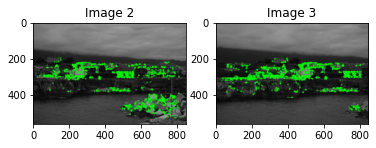

In [68]:
# Initiate ORB detector

orb = cv2.ORB_create(3000)
# find the keypoints and descriptors with ORB
kp2, des2 = orb.detectAndCompute(img2,None)
kp3, des3 = orb.detectAndCompute(img3,None)

# draw only keypoints location,not size and orientation
img2b = cv2.drawKeypoints(img2, kp2, None, color=(0,255,0), flags=0)
img3b = cv2.drawKeypoints(img3, kp3, None, color=(0,255,0), flags=0)
# Plot
fig, (ax1, ax2) = plt.subplots(1, 2)
ax1.set_title('Image 2')
ax2.set_title('Image 3')
ax1.imshow(img2b); ax2.imshow(img3b)
plt.show()

<mark><font size="3"> **ORB:** </mark>

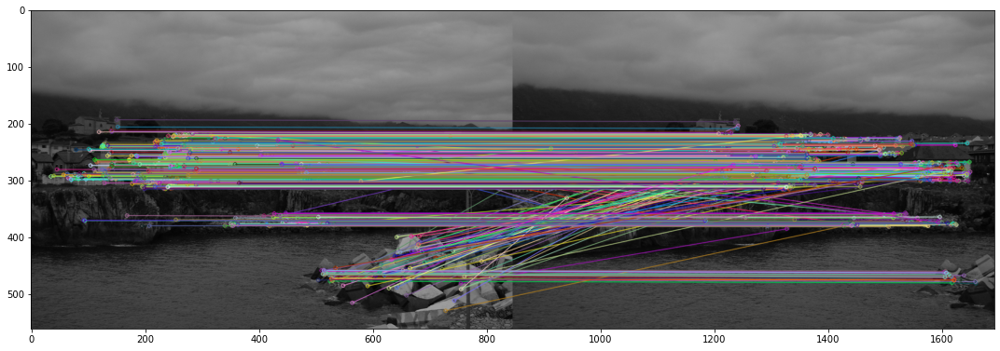

In [69]:
# Keypoint matching 
bf = cv2.BFMatcher()
matches_23 = bf.knnMatch(des2,des3,k=2)
# Apply ratio test
good_matches_23 = []
for m,n in matches_23:
    
    if m.distance < 0.85*n.distance:
        good_matches_23.append([m])

# Show "good" matches 
img_23 = cv2.drawMatchesKnn(img2,kp2,img3,kp3,good_matches_23,None,flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)
plt.imshow(img_23)
fig = matplotlib.pyplot.gcf()
fig.set_size_inches(18.5, 10.5)
plt.show()

<mark><font size="3"> **SIFT:**</mark> 

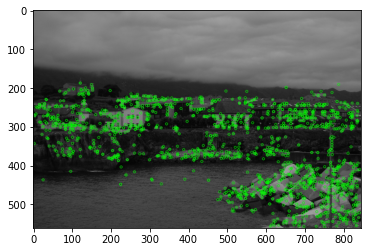

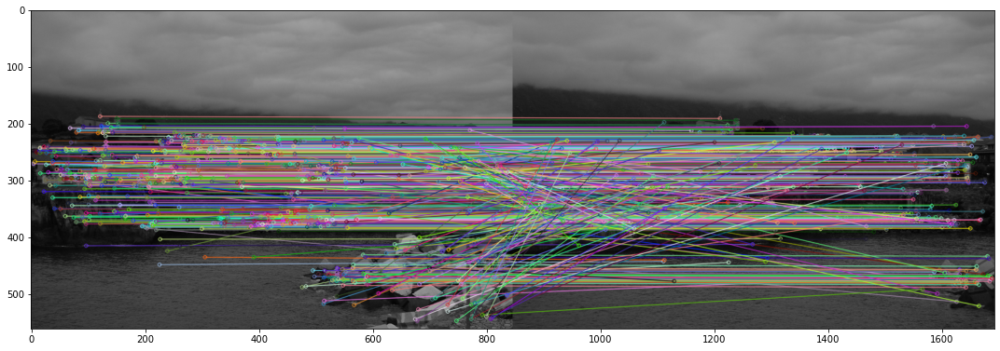

In [70]:
if flag_method != "ORB":
    # Initiate SIFT detector
    sift = cv2.SIFT_create(3000)

    # find the keypoints and descriptors
    kp2, des2 = sift.detectAndCompute(img2,None)
    kp3, des3 = sift.detectAndCompute(img3,None)

    # draw only keypoints location,not size and orientation
    img2b = cv2.drawKeypoints(img2, kp2, None, color=(0,255,0), flags=0)
    plt.imshow(img2b), plt.show()

    # Keypoint matching
    bf = cv2.BFMatcher(cv2.NORM_L2, crossCheck=True)
    matches_23 = bf.match(des2,des3)

    # Show matches
    img_23 = cv2.drawMatches(img2,kp2,img3,kp3,matches_23,None,flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)
    plt.imshow(img_23)
    fig = matplotlib.pyplot.gcf()
    fig.set_size_inches(18.5, 10.5)
    plt.show()

**Q3.**
Are all the matchings correct? Why?

<mark> <font size="3"> **Answer:** </mark>

Not all matches are correct, since there are some parts of the image that may be similar and therefore the algorithm detects that they are the same between both images. Also, there are slightly different view changes between the images that make the detection harder. 
    
Therefore, we need to apply some computations in order to distinguish between the good and bad matchings and take only those that describe correctly the relationship between both images.

## **2. Compute the homography (robust DLT algorithm) between image pairs**

We want now to compute the homography that relates each pair of images. From  the last assignment, we have a function called `DLT_homography` that computes a homography given a set of correspondences. Unfortunately, this only works when all of the correspondences are correct, which is not the case in most practical applictions as the current one. This time, we will need to use the RANSAC method in order to find the correct correspondences and discard the others.

For that we use the functions `Ransac_DLT_homography` and `Inliers` that you have 
to complete below (this is part of questions Q5 and Q6 below).


In [71]:
def Inliers(H, points1, points2, th):
   
    # Check that H is invertible
    if abs(math.log(np.linalg.cond(H))) > 15: 
        idx = np.empty(1)
        return idx
    
    inliers_indices = []
    # normalize just in case
    points1/=points1[2,:]
    points2/=points2[2,:]
    
    for j in range(points1.shape[1]):
        x_prima_j = points2[:,j]
        x_j = points1[:,j]
        
        # compute the distance between points and their projections
        dist1 = x_prima_j - np.dot(H, x_j)
        dist2 = np.dot(np.linalg.inv(H),x_prima_j)-x_j
        dist = np.linalg.norm(dist1) + np.linalg.norm(dist2)
        
        # append only those points whose distance is inside the threshold
        if dist<th:
            inliers_indices.append(j)
    
    
    return np.asarray(inliers_indices)

In [72]:
def Ransac_DLT_homography(points1, points2, th, max_it):
    
    Ncoords, Npts = points1.shape
    
    it = 0
    best_inliers = np.empty(1)
    N = max_it

    while it < N:
        # minimum number of samples to compute a homography
        L = 4
        indices = random.sample(range(1, Npts), L)
        # compute the homography for only those 4 samples 
        H = DLT_homography(points1[:,indices], points2[:,indices])
        
        # taking the computed H, check how much it relates to all points in the dataset
        # by checking the number of inliers that we obtain with that homograpgy
        inliers = Inliers(H, points1, points2, th)
        
        # test if it is the best model so far:
        # save only the best inliers of all iterations, namely the one with more inliers
        if inliers.shape[0] > best_inliers.shape[0]:
            best_inliers = inliers
            
        # iterate again in case in the next iteration we obtain something better
        it += 1
    
    # compute H for the best model found
    H = DLT_homography(points1[:,best_inliers], points2[:,best_inliers])
    inliers = best_inliers
    
    return H, inliers, N
    

The following code allows to robustly estimate the homography that relates images 1 and 2. Examine the code and answer the questions below.

<mark><font size="3"> **ORB:** </mark>

In [73]:
# # take pair of points
if (flag_method == "ORB"):
    points1 = []
    points2 = []
    for m in good_matches_12: # matches_12 instead, if you use SIFT
        points1.append([kp1[m[0].queryIdx].pt[0], kp1[m[0].queryIdx].pt[1], 1]) # m.queryIdx instead, if you use SIFT
        points2.append([kp2[m[0].trainIdx].pt[0], kp2[m[0].trainIdx].pt[1], 1]) # m.trainIdx instead, if you use SIFT

    points1 = np.asarray(points1)
    points1 = points1.T
    points2 = np.asarray(points2)
    points2 = points2.T

<mark><font size="3"> **SIFT:** </mark>

In [74]:
if (flag_method == "SIFT"):
    points1 = []
    points2 = []
    for m in matches_12: # matches_12 instead, if you use SIFT
        points1.append([kp1[m.queryIdx].pt[0], kp1[m.queryIdx].pt[1], 1]) # m.queryIdx instead, if you use SIFT
        points2.append([kp2[m.trainIdx].pt[0], kp2[m.trainIdx].pt[1], 1]) # m.trainIdx instead, if you use SIFT

    points1 = np.asarray(points1)
    points1 = points1.T
    points2 = np.asarray(points2)
    points2 = points2.T

<mark><font size="3"> **ORB:** </mark>

In [75]:
# # take homography between images 1 and 2

if flag_method == "ORB":
    th = 50
    max_it = 1000
    H_12, indices_inlier_matches_12, N = Ransac_DLT_homography(points1, points2, th, max_it)
    inlier_matches_12 = itemgetter(*indices_inlier_matches_12)(good_matches_12) # matches_12 instead, if you use SIFT

    img_12 = cv2.drawMatchesKnn(img1,kp1,img2,kp2,inlier_matches_12,None,flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)
    plt.imshow(img_12)
    fig = matplotlib.pyplot.gcf()
    fig.set_size_inches(18.5, 10.5)
    plt.show()

<mark><font size="3"> **SIFT:** </mark>

Number of points:  875


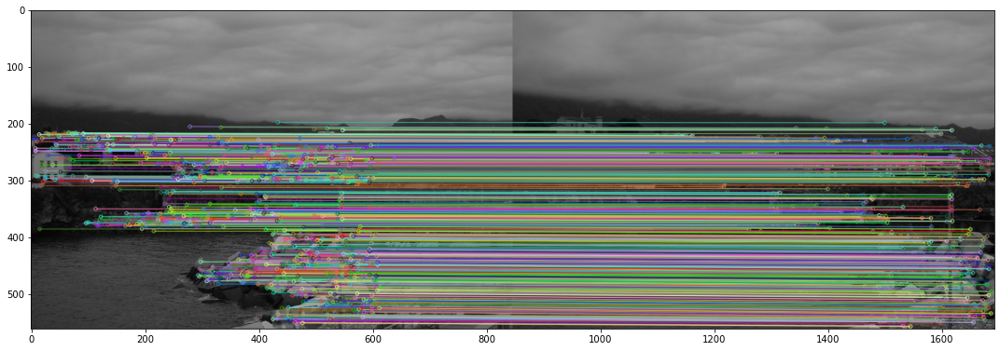

In [77]:
if flag_method == "SIFT":
    th = 50
    max_it = 1000
    H_12, indices_inlier_matches_12, N = Ransac_DLT_homography(points1, points2, th, max_it)
    inlier_matches_12 = itemgetter(*indices_inlier_matches_12)(matches_12) # matches_12 instead, if you use SIFT

    print('Number of points: ', len(inlier_matches_12))
    
    img_12 = cv2.drawMatches(img1,kp1,img2,kp2,inlier_matches_12,None,flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)
    plt.imshow(img_12)
    fig = matplotlib.pyplot.gcf()
    fig.set_size_inches(18.5, 10.5)
    plt.show()

**Q4.** What are the variables `points1` and `points2`?

<mark> <font size="3"> **Answer:** </mark>

Points1 and points2 corresponds to the keypoints found for images 1 and 2. Therefore, we need to find the matches between those points and append them in the correct order in an array that contains them all.

Complete the `Ransac_DLT_homography` function by answering the following questions:

**Q5.** Set the number of samples to choose randomly and that will define the model to test in each trial. (second input parameter of function `random.sample`).

<mark> <font size="3"> **Answer:** </mark>

Although we could chose more samples, the minimum number we need to correctly estimate a homography is 4.

**Q6.** Complete the function `Inliers` by computing the geometric error of the correspondences given the homography.

**Q7.** What is the input parameter `th` when calling the `Ransac_DLT_homography` function? Choose a good value for this parameter and justify your answer.

<mark> <font size="3"> **Answer:** </mark>
    
'th' corresponds to the maximum distance between points and their projections we take to consider that a match is descriptive enough. The best way to choose this threshold is by doing trial and error and taking the one that gives a good enough number of inliers that are visually similar, since its value highly depends on the size of the image and therefore it will be different for each pair. We solve it by doing a loop and choose the threshold that gives the better model.
    
In this case, when the threshold is higher than 300 we start obtaining bad inliers, and we notice that there is no big difference in the inliers we get with a threshold between 50 and 200, so a good value may be 50.

1
indices:  70
points:  70


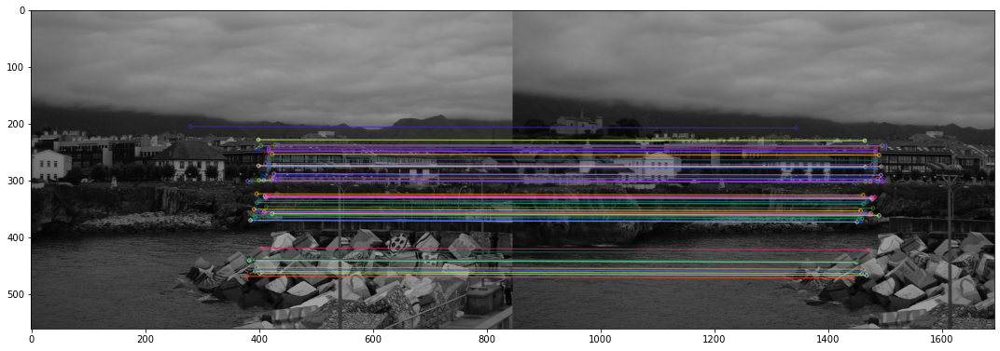

51
indices:  875
points:  875


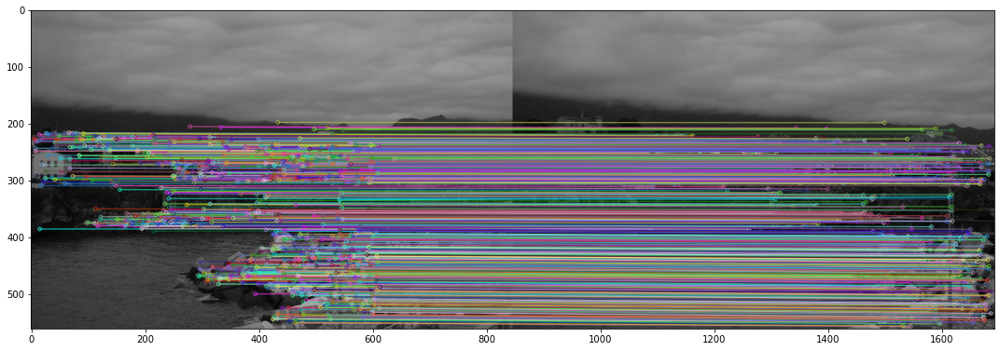

101
indices:  883
points:  883


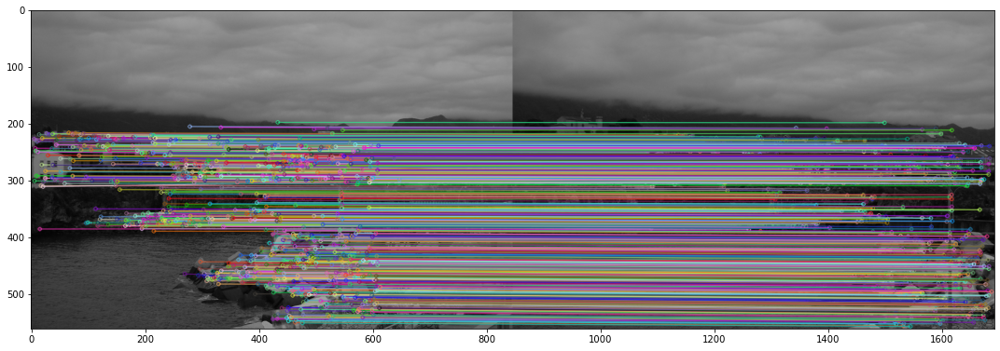

151
indices:  887
points:  887


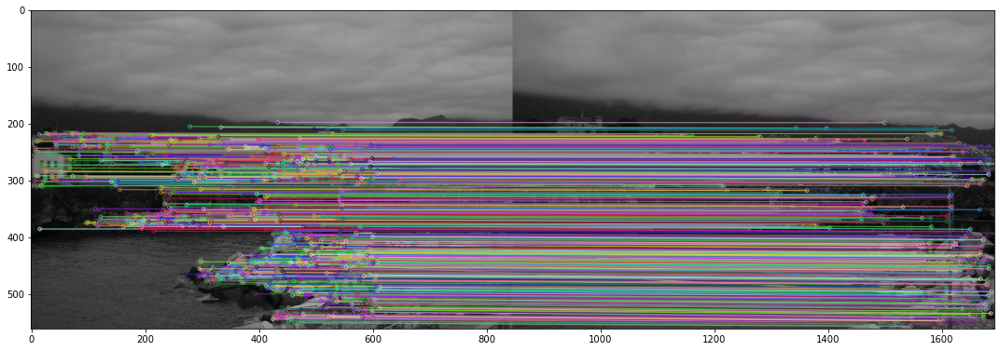

201
indices:  891
points:  891


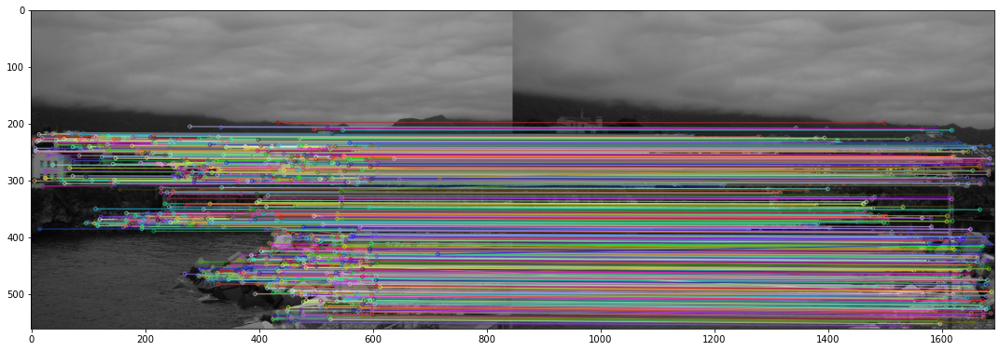

251
indices:  895
points:  895


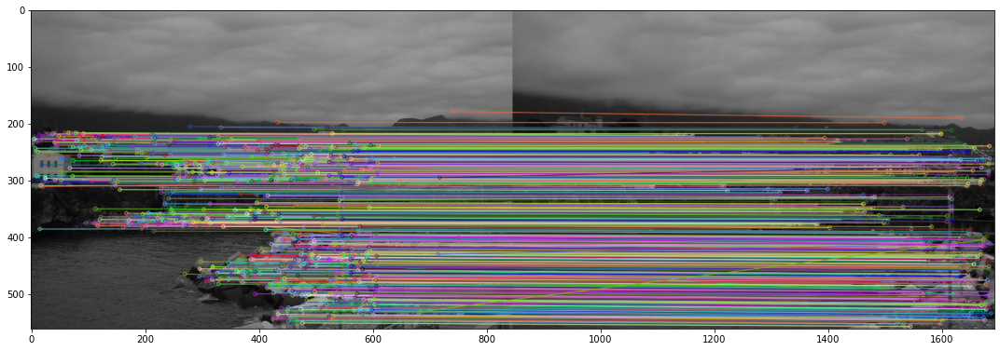

301
indices:  899
points:  899


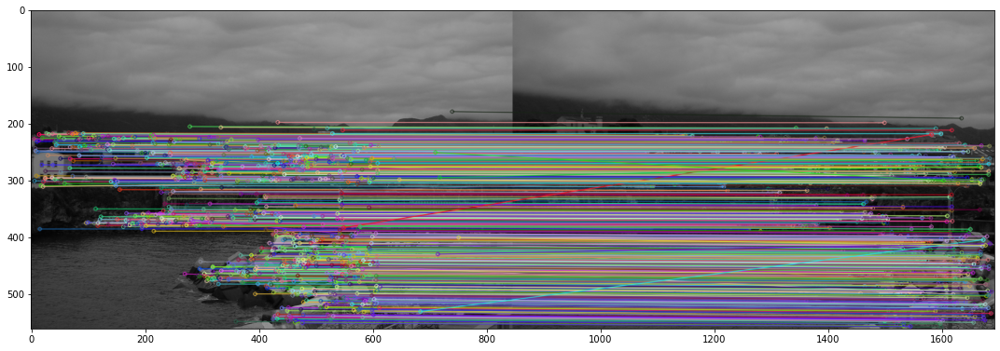

351
indices:  906
points:  906


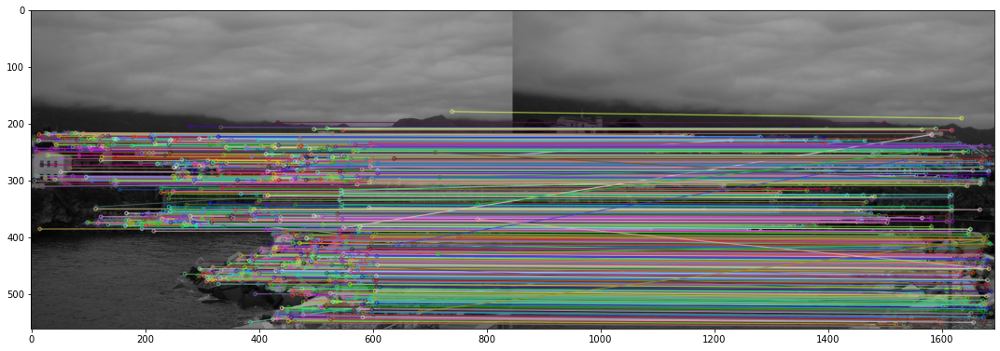

401
indices:  910
points:  910


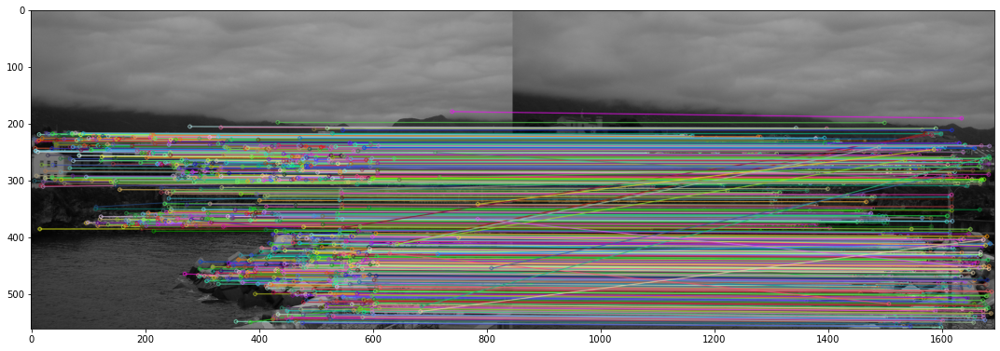

451
indices:  915
points:  915


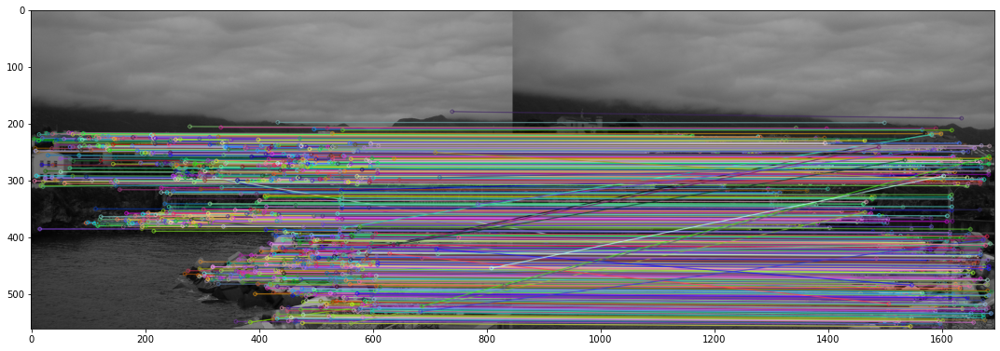

In [23]:
if flag_method == "SIFT":
    for threshold in range (1,500,50):
        th = threshold
        max_it = 1000
        print('Threshold: ' + str(th))
        H_12, indices_inlier_matches_12, N = Ransac_DLT_homography(points1, points2, th, max_it)
        inlier_matches_12 = itemgetter(*indices_inlier_matches_12)(matches_12) # matches_12 instead, if you use SIFT

        print('Number of points: ', len(inlier_matches_12))

        img_12 = cv2.drawMatches(img1,kp1,img2,kp2,inlier_matches_12,None,flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)
        plt.imshow(img_12)
        fig = matplotlib.pyplot.gcf()
        fig.set_size_inches(18.5, 10.5)
        plt.show()

**Q8.** Create a new function `Ransac_DLT_homography_adaptive_loop` which is based on the function `Ransac_DLT_homography` and automatically adapts the number of trials to ensure we pick, with a probability $p=0.99$ an initial data set with no outliers.

In [78]:
def Ransac_DLT_homography_adaptive_loop(points1, points2, th):
    
    Ncoords, Npts = points1.shape
    
    it = 0
    best_inliers = np.empty(1)
    
    # initiate N with a very large number
    N = 1000000
    sample_count = 0
    s = 4
    p = 0.99
    
    while N > sample_count:
        
        L = 4 # number of samples to choose randomly
        indices = random.sample(range(1, Npts), L)
        H = DLT_homography(points1[:,indices], points2[:,indices])
        inliers = Inliers(H, points1, points2, th)
        
        # test if it is the best model so far
        if inliers.shape[0] > best_inliers.shape[0]:
            best_inliers = inliers
        
        # Compute new N
        num_best_inliers = len(best_inliers)
        w = num_best_inliers / points1.shape[1]
        N = np.log(1-p)/np.log(1-(w**s))
    
        sample_count += 1
            
#     print('Number of iterations: ' + str(N))
        
    # compute H from all the inliers
    H = DLT_homography(points1[:,best_inliers], points2[:,best_inliers])
    inliers = best_inliers
    
    return H, inliers, N


**Q9.** Compare experimentally the two versions of the RANSAC algorithm (`Ransac_DLT_homography` and `Ransac_DLT_homography_adaptive_loop`) in terms of the number of iterations. Which version is better and why?

<mark> <font size="3"> **Answer:** </mark>

Experimentally, we notice that adapting the number of iterations gives greater efficiency, since with the first method we need a fixed number of iterations (1000), while in general the second one is more efficient since the number of iterations is adapted in order to find the same number of inliers but with less iterations. The problem is that not always the number of iterations will be reduced depending on the threshold we use and the image information we obtain, since in some cases if the threshold is very low or the image has a lower number of keypoints, it may be very hard to obtain a 0.99 percent of probability that we obtain inliers.
    
For this reason we draw a plot to better see how the number of iterations is affected by the threshold we use, knowing that with a lower threshold we will need more iterations to reach the condition that may be greater than the ones we will use in the fixed one. For instance, with a threshold of 50, the adaptative method only needs 6 iterations with respect to the normal that needs 1000.

<mark><font size="3"> **EXPERIMENTAL PLOT ( N vs thr) :** </mark>

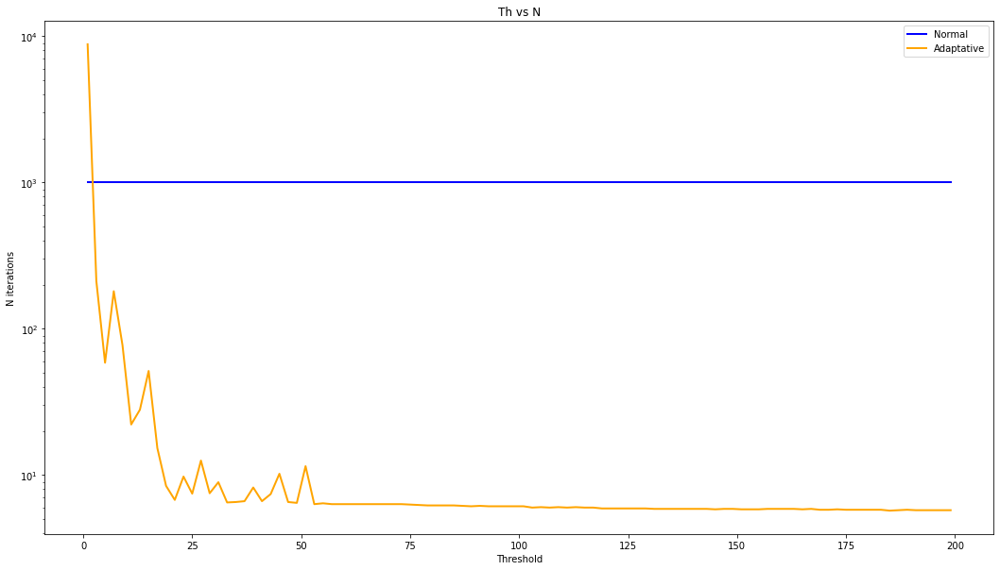

In [80]:
th_list = range(1,200,2)
N_list_adaptive = []
N_list = []
max_it = 1000
for th in th_list:
    if flag_method == "SIFT":
        _, indices_inlier_matches_12, N_adaptive = Ransac_DLT_homography_adaptive_loop(points1, points2, th)
        _, indices_inlier_matches_12, N = Ransac_DLT_homography(points1, points2, th, max_it)

        N_list_adaptive.append(N_adaptive)
        N_list.append(N)
        
    
fig = plt.figure(figsize=(18,10))
ax = fig.add_subplot(1, 1, 1)

line, = ax.plot(th_list, N_list, color='blue', lw=2, label="Normal")
line2, = ax.plot(th_list, N_list_adaptive, color='orange', lw=2, label="Adaptative")

ax.set_yscale('log')

plt.title('Th vs N')
plt.xlabel('Threshold')
plt.ylabel('N iterations')
plt.legend()
plt.show()

**Q10.** Compute the homography that relates images 2 and 3. Write the commands you used for that.

<mark><font size="3"> **ORB:** </mark>

In [81]:
# # # Homography between images 2 and 3
if (flag_method == "ORB"):
    points2 = []
    points3 = []
    for m in good_matches_23: # matches_23 instead, if you use SIFT
        points3.append([kp2[m[0].queryIdx].pt[0], kp2[m[0].queryIdx].pt[1], 1]) # m.queryIdx instead, if you use SIFT
        points3.append([kp3[m[0].trainIdx].pt[0], kp3[m[0].trainIdx].pt[1], 1]) # m.trainIdx instead, if you use SIFT

    points2 = np.asarray(points2)
    points2 = points2.T
    points3 = np.asarray(points3)
    points3 = points3.T

<mark><font size="3"> **SIFT:** </mark>

In [82]:
if (flag_method == "SIFT"):
    points2 = []
    points3 = []
    for m in matches_23: # matches_23 instead, if you use SIFT
        points2.append([kp2[m.queryIdx].pt[0], kp2[m.queryIdx].pt[1], 1]) # m.queryIdx instead, if you use SIFT
        points3.append([kp3[m.trainIdx].pt[0], kp3[m.trainIdx].pt[1], 1]) # m.trainIdx instead, if you use SIFT

    points2 = np.asarray(points2)
    points2 = points2.T
    points3 = np.asarray(points3)
    points3 = points3.T

<mark><font size="3"> **ORB:** </mark>

In [85]:
if flag_method == "ORB":
    th = 50
    H_23, indices_inlier_matches_23 = Ransac_DLT_homography_adaptive_loop(points2, points3, th)
    inlier_matches_23 = itemgetter(*indices_inlier_matches_23)(good_matches_23) # matches_23 instead, if you use SIFT

    # drawMatches instead of drawMatchesKnn if you use SIFT
    img_23 = cv2.drawMatchesKnn(img2,kp2,img3,kp3,inlier_matches_23,None,flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)
    plt.imshow(img_23)
    fig = matplotlib.pyplot.gcf()
    fig.set_size_inches(18.5, 10.5)
    plt.show()

<mark><font size="3"> **SIFT:** </mark>

Number of points:  577


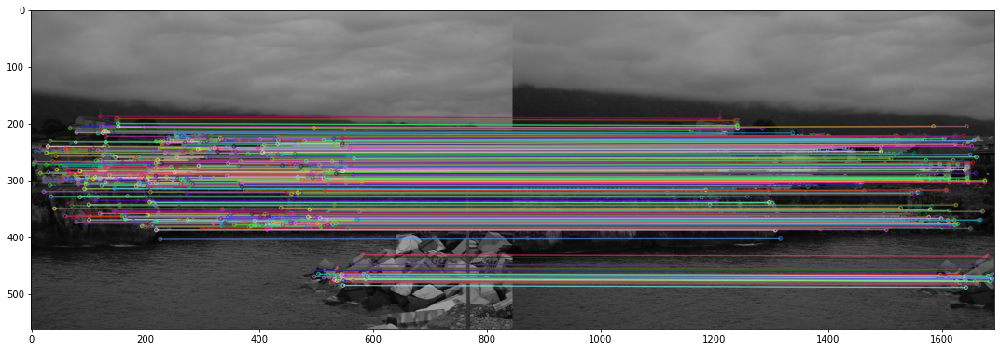

In [87]:
if flag_method == "SIFT":
    th = 50
    H_23, indices_inlier_matches_23, N = Ransac_DLT_homography_adaptive_loop(points2, points3, th)
#     H_23, indices_inlier_matches_23 = Ransac_DLT_homography(points2, points3, th,1000)
    inlier_matches_23 = itemgetter(*indices_inlier_matches_23)(matches_23) # matches_23 instead, if you use SIFT

    print('Number of points: ', len(inlier_matches_23))
    
    # drawMatches instead of drawMatchesKnn if you use SIFT
    img_23 = cv2.drawMatches(img2,kp2,img3,kp3,inlier_matches_23,None,flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)
    plt.imshow(img_23)
    fig = matplotlib.pyplot.gcf()
    fig.set_size_inches(18.5, 10.5)
    plt.show()

## **3. Build the mosaic**

At this point we have all the ingredients to build the image mosaic. For transforming an image with a specified homography we use a modification of the function `apply_H` used in the previous practical session. The modified function `apply_H_fixed_image_size` transforms the input image according to the input homography and writes it in an output image of size corresponding to the input vector of desired corner coordinates.

Examine and complete the code below when necessary.

**Q11.** Which homography we use for transforming the image 2? Why?

**Q12.** How are the two images combined in the mosaic image? Why?

**Q13.** Complete the mosaic including the third image. Write the commands you used for that.

<mark> <font size="3"> **Answers:** </mark>

- Q11 & Q12: 
In this case to find the homography between images 1, 2 and 3 we need 3 matrices:
    - The homography matrix from 1 to 2, namely $H_{12}$.
    - The identity matrix.
    - The inverse matrix of homography matrix of $H_{23}$, namely we need this goes from 3 to 2.
    
This is because we first take the img1 and use the function to transform it according to the homography $H_{1-to-2}$.
More specifically, this matrix explain us the best homogrphy that we can find to matches the best correspondences between img 1 and img 2.
    
Then, for img 2 we only need to put the identity matrix since we treat it like the 'fix' one, and we don't want it to have any transformation. Later on, since we want to combine img 3 to the img2, we need that this homography goes from img3 to img2, therefore, we just need to invert $H_{2-to-3}$ and then transform this final img3.

Then, after transforming all the images according to the corner we pass, we try to find the maximum for each pair of transformations, namely, mosaic img between [1 and 2], then [2 and 3], and then find the maximum of this both, which is the final mosaic image of 1, 2 and 3.

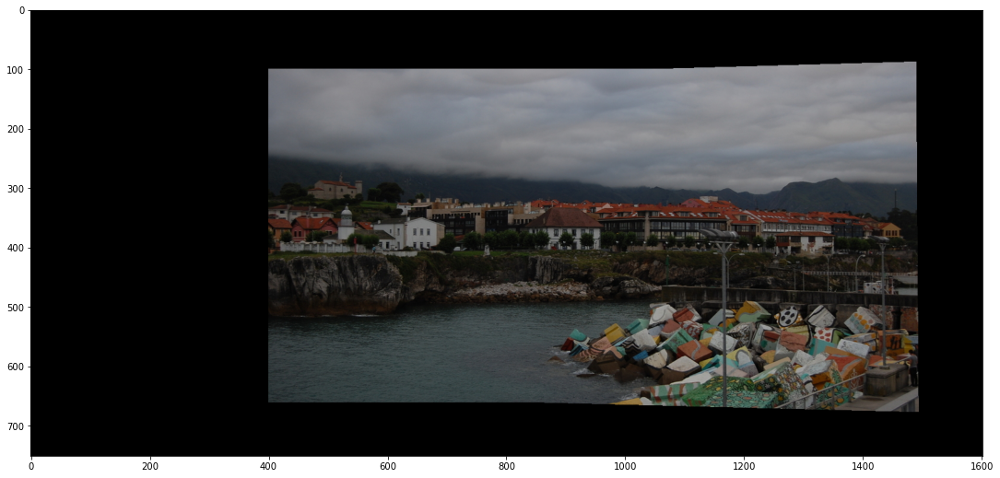

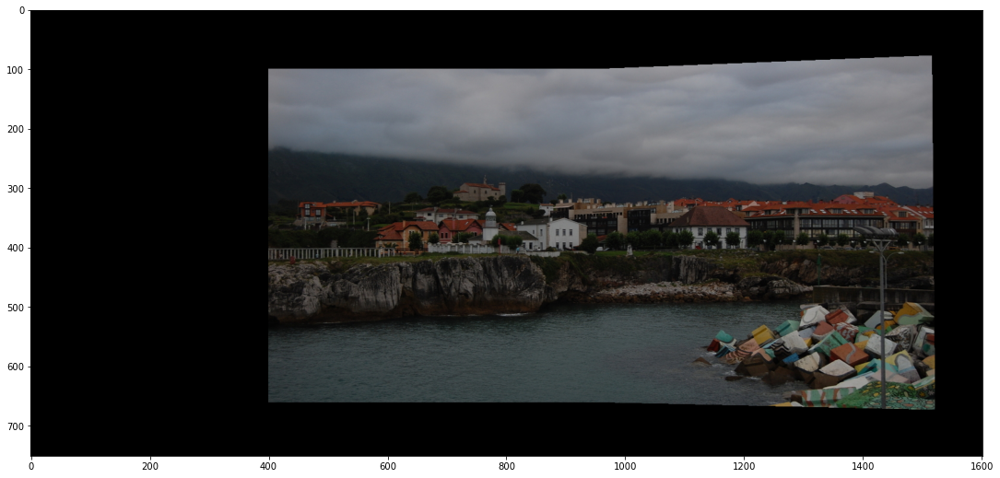

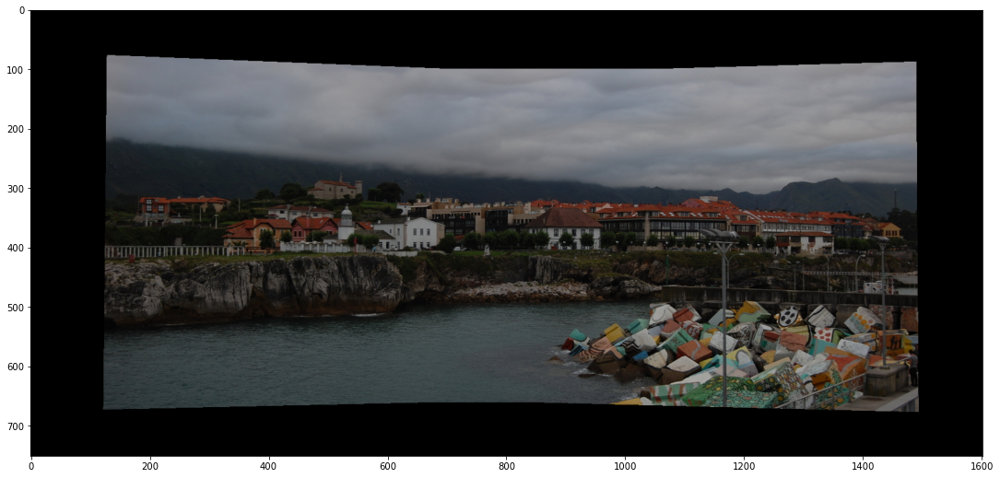

In [88]:
corners = [-400, 1200, -100, 650]

#print(img1.shape)
img1c = cv2.imread('Data/Llanes/llanes_a.jpg',cv2.IMREAD_COLOR)
img2c = cv2.imread('Data/Llanes/llanes_b.jpg',cv2.IMREAD_COLOR)
img3c = cv2.imread('Data/Llanes/llanes_c.jpg',cv2.IMREAD_COLOR)
img1c = cv2.cvtColor(img1c, cv2.COLOR_BGR2RGB)
img2c = cv2.cvtColor(img2c, cv2.COLOR_BGR2RGB)
img3c = cv2.cvtColor(img3c, cv2.COLOR_BGR2RGB)

# mosaic 1-2
img1c_w = apply_H_fixed_image_size(img1c, H_12, corners)
img2c_w = apply_H_fixed_image_size(img2c, np.identity(3), corners)
img_mosaic_12 = np.maximum(img1c_w,img2c_w)
plt.imshow(img_mosaic_12)
fig = matplotlib.pyplot.gcf()
fig.set_size_inches(18.5, 10.5)
plt.show()

# mosaic 2-3
img2c_w = apply_H_fixed_image_size(img2c, H_23, corners)
img3c_w = apply_H_fixed_image_size(img3c,np.identity(3) , corners)
img_mosaic_23 = np.maximum(img2c_w,img3c_w)
plt.imshow(img_mosaic_23)
fig = matplotlib.pyplot.gcf()
fig.set_size_inches(18.5, 10.5)
plt.show()

# mosaic 1-2-3
img1c_w_p = apply_H_fixed_image_size(img1c,H_12, corners)
img2c_w_p = apply_H_fixed_image_size(img2c,np.identity(3), corners) 
img3c_w_p = apply_H_fixed_image_size(img3c,np.linalg.inv(H_23), corners)

img_mosaic_12_p = np.maximum(img1c_w_p, img2c_w_p)
img_mosaic_23_p = np.maximum(img2c_w_p, img3c_w_p)
img_mosaic_123 = np.maximum(img_mosaic_12_p, img_mosaic_23_p)

plt.imshow(img_mosaic_123)
fig = matplotlib.pyplot.gcf()
fig.set_size_inches(18.5, 10.5)
plt.show()


<mark> <font size="4"> **Analization for images of Llanes folder** </mark>

In this case it works perfectly, since we obtain a considerable number of key points and their respectively SIFT descriptors (which is they are very discriminative). Also, we obtain a considerable number of correspondences by marching these features, and discard those outliers using RANSAC algorithm. Then to find the homography we also use DLT given a set of correct correspondences. Finally, we use this homography to obtain the final mosaic image.

So, it works well when the image is in a well-defined condition since it does not have similar patterns and there are lots of gradient changes, so we can find numerous correspondences easily.
    

**Q14.** **(Optional)** Create a function that takes as input the path to the folder where the images to construct the panorama are located. The function should work independently of the number of images that are located in the folder (assume that the images are given in the correct order).

<mark> <font size="3">**Answer:**</mark>

We created a new version to manage very large N for some of the images by defining a max_iterations value. This allows us to apply the algorithm to the images faster for some of the images, but we also need to take into account that then the results may be worse than expected since in some cases we will be iterating less that we should.

In [103]:
# we define this version of funtion with addition max_it parameter
def Ransac_DLT_homography_adaptive_loop(points1, points2, th, max_it):
    
    Ncoords, Npts = points1.shape
    
    it = 0
    best_inliers = np.empty(1)
    
    # initiate N with a very large number
    N = 1000000
    sample_count = 0
    s = 4
    p = 0.99
    
    # put another condition to prevent N from very large numbers,
    # that is, we never iterate more than the max_it to avoid very large execution time
    while N > sample_count and sample_count < max_it:
        
        L = 4 # number of samples to choose randomly
        indices = random.sample(range(1, Npts), L)
        H = DLT_homography(points1[:,indices], points2[:,indices])
        inliers = Inliers(H, points1, points2, th)
        
        # test if it is the best model so far
        if inliers.shape[0] > best_inliers.shape[0]:
            best_inliers = inliers
        
        # Compute new N
        num_best_inliers = len(best_inliers)
        w = num_best_inliers / points1.shape[1]
        N = np.log(1-p)/np.log(1-(w**s))
    
        sample_count += 1
            
    print('Number of iterations: ' + str(N))
        
    # compute H from all the inliers
    H = DLT_homography(points1[:,best_inliers], points2[:,best_inliers])
    inliers = best_inliers
    
    return H, inliers

In [91]:
import os
import numpy as np
import cv2
import random
import math
import sys
import matplotlib
from matplotlib import pyplot as plt
from operator import itemgetter
from utils import apply_H_fixed_image_size, Normalization, DLT_homography
#

In [92]:
def panorama(path_images, th, max_it, num_of_kp , corners, plot_matches):
    
    # INPUTS:
        #path_images: path to the folder that contain the images
    # OTPUT: 
        # P: panoarama image    
    
    # 1) READ ALL THE IMAGES OF THE INPUT PATH  
    images = os.listdir(path_images)
    if '.DS_Store' in images:
        images.remove('.DS_Store')

    img_list_gray = []
    img_list_rgb = []
    for image in images:
        full_path = path_images + '/' + image
        img_list_gray.append(cv2.imread(full_path,cv2.IMREAD_GRAYSCALE))
        img_list_rgb.append(cv2.imread(full_path,cv2.IMREAD_COLOR))
    
    img1 = img_list_gray[0]
    img2 = img_list_gray[1]
    h, w = img1.shape[:2]
    img1c = cv2.cvtColor(img_list_rgb[0], cv2.COLOR_BGR2RGB)
    img2c = cv2.cvtColor(img_list_rgb[1], cv2.COLOR_BGR2RGB)
    
    # 2) COMPUTE THE IMAGE KEYPOINTS OF THE IMAGES
    print("COMPUTE THE IMAGE KEYPOINTS OF THE IMAGES...")

    # SIFT
    sift = cv2.SIFT_create(num_of_kp)

    # find the keypoints and descriptors
    kp1, des1 = sift.detectAndCompute(img1,None)
    kp2, des2 = sift.detectAndCompute(img2,None)

    # 3) MATCH THE KEYPOINTS
    print("MATCH THE KEYPOINTS...")

    #PLOT of KEYPOINTS draw only keypoints location,not size and orientation
#     img1b = cv2.drawKeypoints(img1, kp1, None, color=(0,255,0), flags=0)
#     plt.imshow(img1b), plt.show()

    # Keypoint matching
    bf = cv2.BFMatcher(cv2.NORM_L2, crossCheck=True)
    matches_12 = bf.match(des1,des2)


     #  PLOT Show matches
#         img_12 = cv2.drawMatches(img1,kp1,img2,kp2,matches_12,None,flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)
#         plt.imshow(img_12)
#         fig = matplotlib.pyplot.gcf()
#         fig.set_size_inches(18.5, 10.5)
#         plt.show()

    # 4) COMPUTE THE HOMOGRAPIES
    print("COMPUTE THE HOMOGRAPIES...")
    points1 = []
    points2 = []
    for m in matches_12: # matches_12 instead, if you use SIFT
        points1.append([kp1[m.queryIdx].pt[0], kp1[m.queryIdx].pt[1], 1]) # m.queryIdx instead, if you use SIFT
        points2.append([kp2[m.trainIdx].pt[0], kp2[m.trainIdx].pt[1], 1]) # m.trainIdx instead, if you use SIFT

    points1 = np.asarray(points1)
    points1 = points1.T
    points2 = np.asarray(points2)
    points2 = points2.T

    H_12, indices_inlier_matches_12 = Ransac_DLT_homography_adaptive_loop(points1, points2, th, max_it)
    
    if plot_matches:
        inlier_matches_12 = itemgetter(*indices_inlier_matches_12)(matches_12) # matches_12 instead, if you use SIFT

        img_12 = cv2.drawMatches(img1,kp1,img2,kp2,inlier_matches_12,None,flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)
        plt.imshow(img_12)
        fig = matplotlib.pyplot.gcf()
        fig.set_size_inches(18.5, 10.5)
        plt.show()

    # 5) BUILD THE MOSAIC
    print("BUILD THE MOSAIC...")
    img1c_w = apply_H_fixed_image_size(img1c, H_12, corners)
    img2c_w = apply_H_fixed_image_size(img2c, np.identity(3) , corners)
    img_mosaic_12 = np.maximum(img1c_w,img2c_w)

    plt.imshow(img_mosaic_12)
    fig = matplotlib.pyplot.gcf()
    fig.set_size_inches(18.5, 10.5)
    plt.show()
    
    return img_mosaic_12


**Q15** Construct the panorana image of each folder present in the Data folder and explain why it works or not in each case. In the scenarios that it does not work properly, suggest how you would try to improve the result obtained.

Note 1 : Use the function created above if the case, otherwise repeate the code for each pair of images.

Note 2: You will need to define new corner for panoram as the images bigger and positioned different, trick look the dimension of the images to thefine the corners of each case.

COMPUTE THE IMAGE KEYPOINTS OF THE IMAGES...
MATCH THE KEYPOINTS...
COMPUTE THE HOMOGRAPIES...
Number of iterations: 106.72917313433544


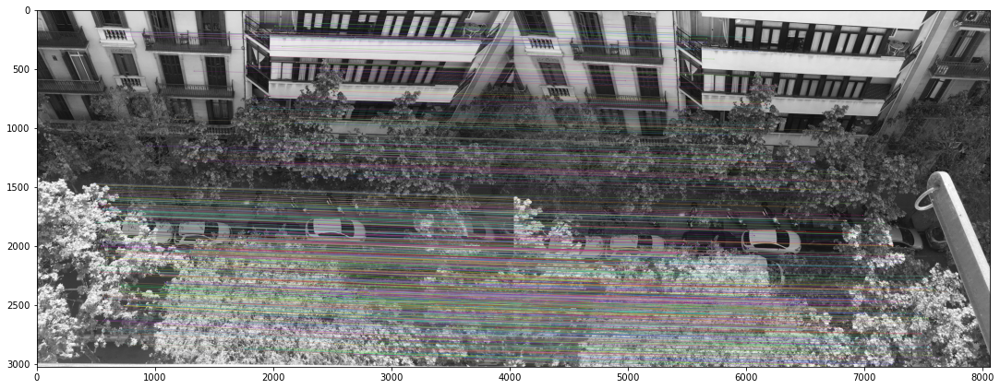

BUILD THE MOSAIC...


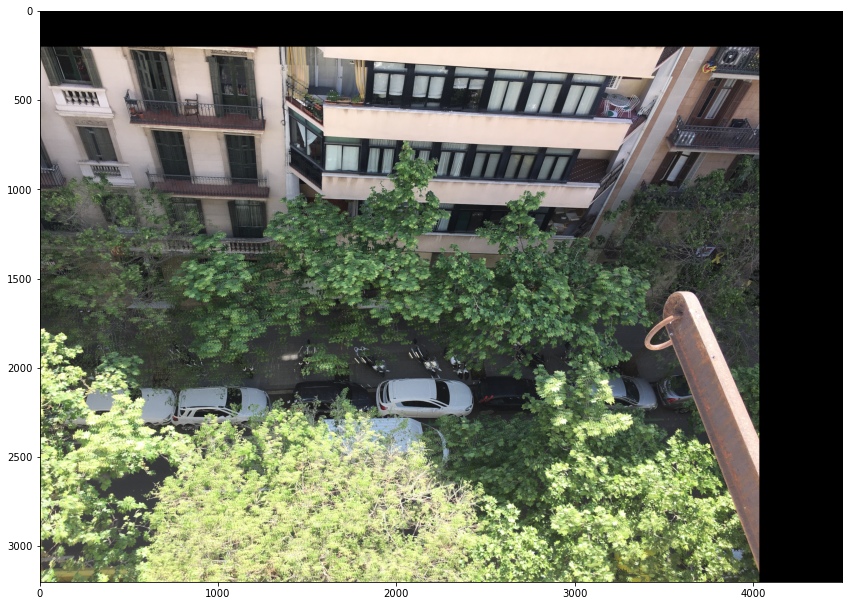

In [102]:
th = 300
max_it = 10000
num_of_kp = 3000*3
path_images = 'Data/Arboles'
corners = [0, 4500, -200, 3000]
img_mosaic_arbol = panorama(path_images, th, max_it, num_of_kp, corners, plot_matches = True)


<mark> <font size="3"> **Analysis for images in Arboles folder** </mark>

The result obtained in this case could be better, since we can notice that most of the image has an eco effect caused because both images are not correctly placed. This happens because the algorithm could not find great descriptors to match them since the image has very similar areas specially the ones with trees which makes it difficult to find a good model and therefore obtain a good result. Also, there are some parts with small details for which we would need higher resolution.
    
This may be also caused by the number of iterations used, so we could try with higher values to see how it improves. On the other hand, the algorithm worked quite well in the houses area even taking account the affine transformation that there is between images one and two in that area, since SIFT is partially invariant to affine transformations.

COMPUTE THE IMAGE KEYPOINTS OF THE IMAGES...
MATCH THE KEYPOINTS...
COMPUTE THE HOMOGRAPIES...
Number of iterations: 4877438775.815348


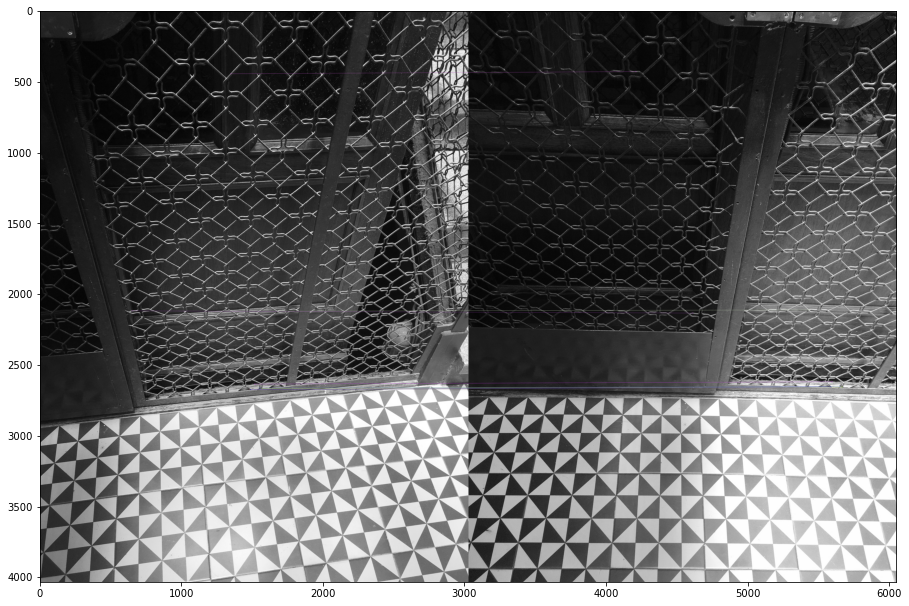

BUILD THE MOSAIC...


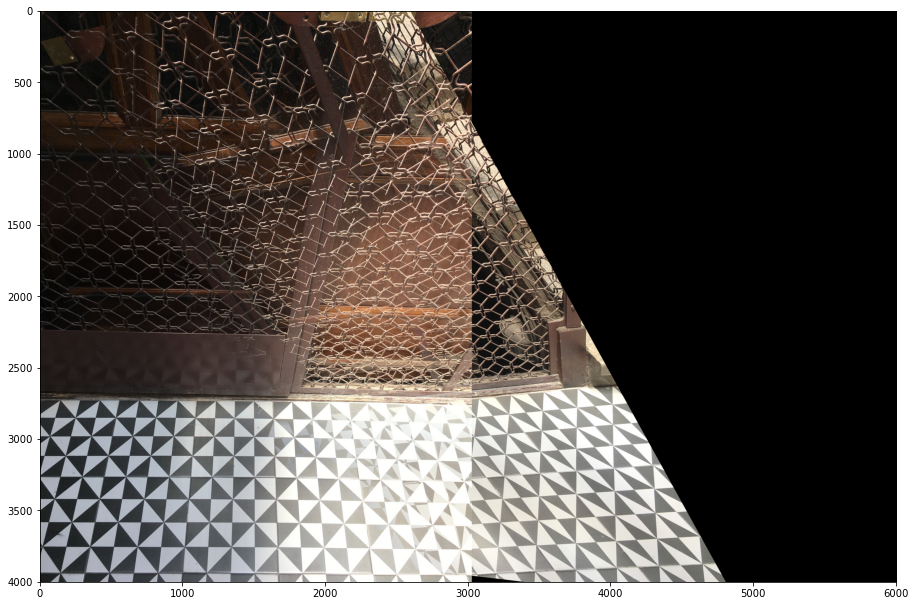

In [94]:
th = 50
max_it = 1000000
num_of_kp = 9000
corners = [0, 6000, 0, 4000]
path_images = 'Data/Ascensor'
img_ascensores = panorama(path_images, th, max_it, num_of_kp, corners, plot_matches = True)

<mark> <font size="3"> **Analysis for images in Ascensores folder** </mark>

This is a very complex case, since the image has very similar and repetitive patterns. For this reason it is very difficult for the algorithm to find good keypoints and especially match them. 
    
It is almost imposible to improve this result taking into account the condition of the image.

COMPUTE THE IMAGE KEYPOINTS OF THE IMAGES...
MATCH THE KEYPOINTS...
COMPUTE THE HOMOGRAPIES...
Number of iterations: 145.42242834321218


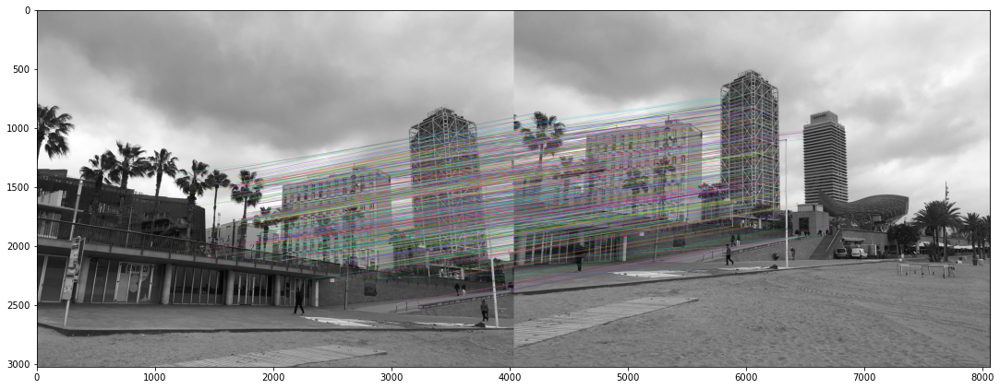

BUILD THE MOSAIC...


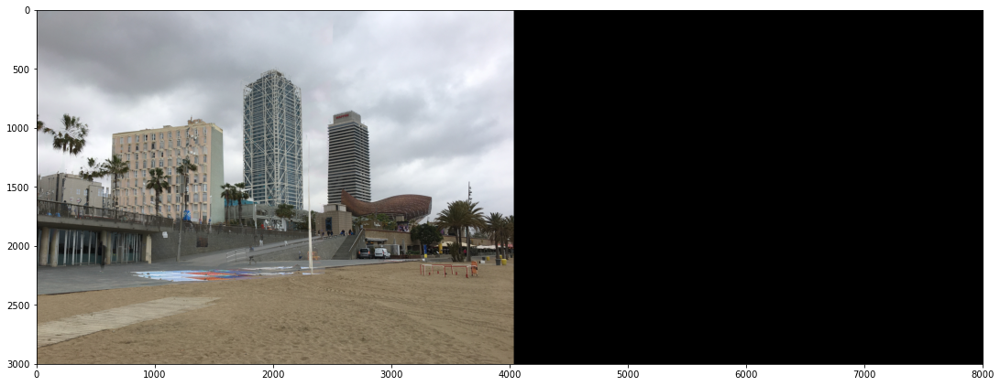

In [106]:
th = 500
corners = [0, 8000, 0, 3000]
max_it = 1000000
num_of_kp = 9000
path_images = 'Data/Barceloneta'

img_baceloneta = panorama(path_images, th, max_it, num_of_kp, corners, plot_matches = True)

<mark> <font size="3"> **Analysis for images in Barceloneta folder** </mark>

The algorithm performed partially fine in this case especially matching the building areas since they are quite disctintive and it could find a large enough number of correspondencess. Even though, it did not work that well in the left part of image which corresponds to the image which we applied the homography. This makes sense, since some of the correspondences found are taking palm trees that are not the same making the model harder to estimate.

This case may be improved by taking another image that fills some of the information in the middle between both of them, since the two images correspond in a very small area in order to combine them.

COMPUTE THE IMAGE KEYPOINTS OF THE IMAGES...
MATCH THE KEYPOINTS...
COMPUTE THE HOMOGRAPIES...
Number of iterations: 163.5307860220339


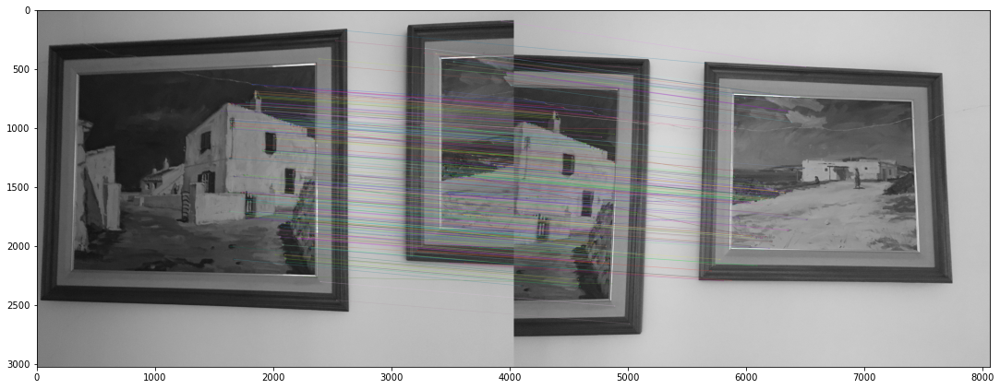

BUILD THE MOSAIC...


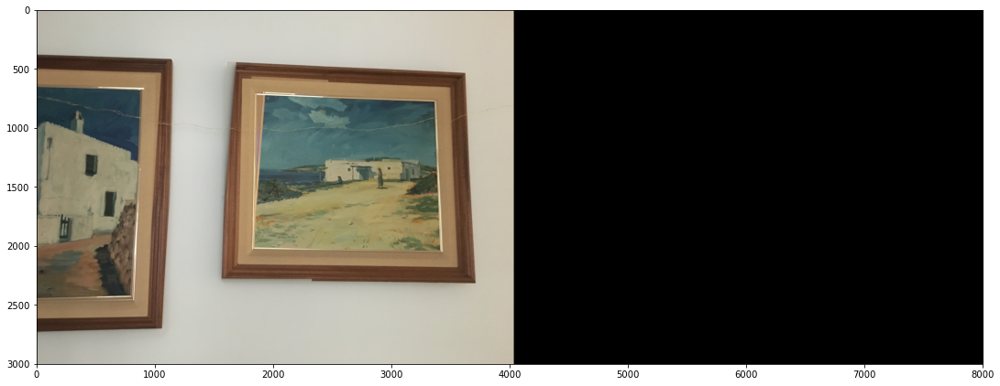

In [110]:
th = 700
corners = [0, 8000, 0, 3000]
max_it = 1000000
num_of_kp = 9000
path_images = 'Data/Cuadros'

img_cuadros = panorama(path_images, th, max_it, num_of_kp, corners, plot_matches = True)

<mark> <font size="3"> **Analysis for images in Cuadros folder** </mark>

In this case the algorithm is almost taking just one of the images and trying to put one in top of the other which is not working properly since we can notice some artefacts in the frame of the pictures. This can be caused by the poor number of keypoints found since most of the areas are flattened by the nature of the painting.
    
We assume that this result cannot be improved, since in this kind of images with less gradient changes it is very difficult to find good descriptors and correspondences.

COMPUTE THE IMAGE KEYPOINTS OF THE IMAGES...
MATCH THE KEYPOINTS...
COMPUTE THE HOMOGRAPIES...
Number of iterations: 887.6456062186148


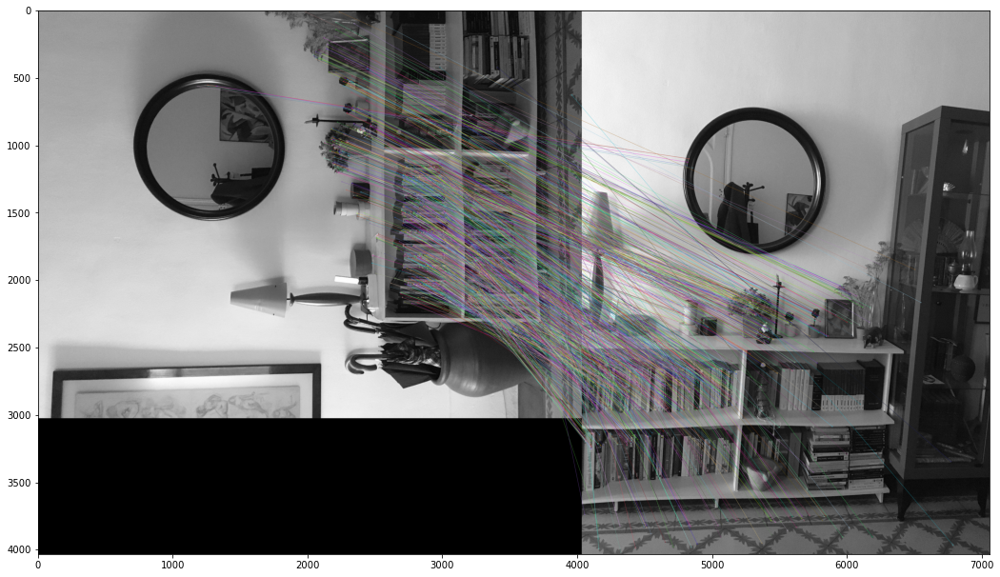

BUILD THE MOSAIC...


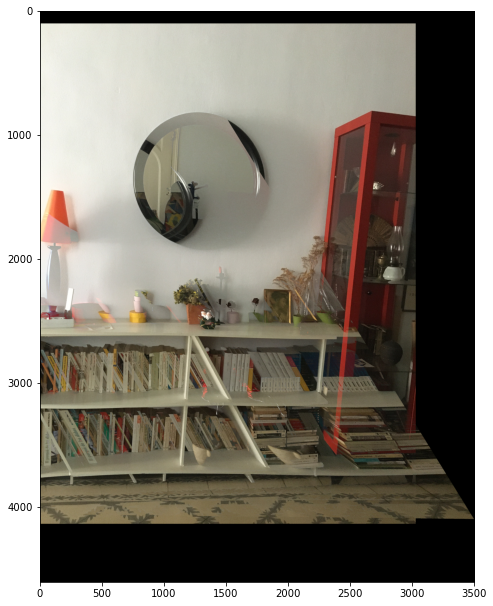

In [97]:
th = 500
max_it = 10000
num_of_kp = 3000*5
path_images = 'Data/Entrada'
corners = [0, 3500, -100, 4500] 
img_mosaic_arbol = panorama(path_images, th , max_it, num_of_kp , corners, plot_matches = True)


<mark> <font size="3"> **Analysis for images in Entrada folder** </mark>

In this complex condition, the reconstruction failed. As we can see in this case the first image is totally orientated 90 degrees with respect to the second one. Then, as we know even though the SIFT descriptor is robust to the rotation, this does not support a really large change of orientation like in this case. Therefore, since we can not find the correct key points and descriptors, nor their respective correspondences, then the homography matrix is also corrupted. So, one way to improve this result is trying to do some preprocessing of the image, in this case, search if the orientation of both images is the same and try to put them in the same way, for example using the object's lines. Then after this correction, do the same process as before to search the mosaic image.

COMPUTE THE IMAGE KEYPOINTS OF THE IMAGES...
MATCH THE KEYPOINTS...
COMPUTE THE HOMOGRAPIES...
Number of iterations: 5.444608017736868


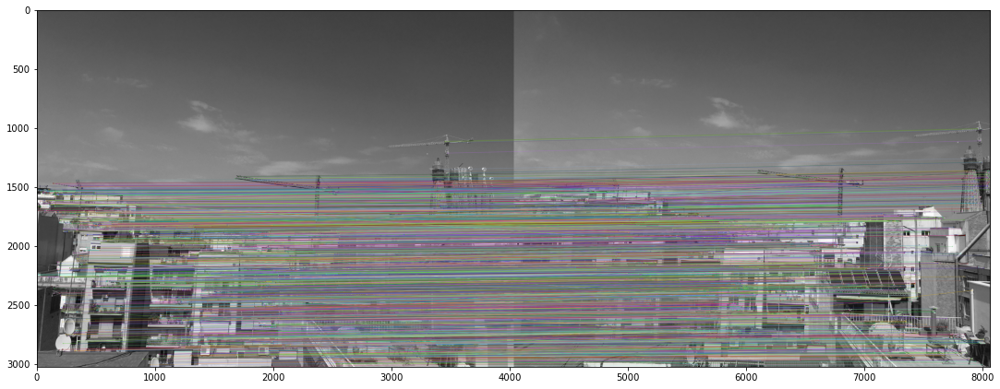

BUILD THE MOSAIC...


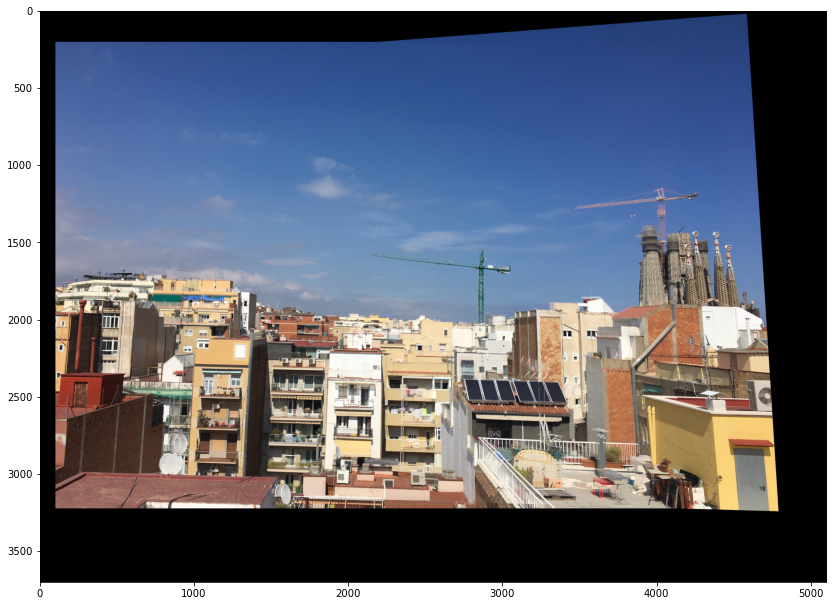

In [98]:
th = 900
max_it = 1000000
num_of_kp = 10000
path_images = 'Data/Exterior'
corners = [-100, 5000, -200, 3500] 
img_mosaic_arbol = panorama(path_images, th , max_it, num_of_kp , corners, plot_matches = True)

<mark> <font size="3"> **Analysis for images in Exterior folder** </mark>

In this case it works partially, we can observe that from left to the middle of the image, we get quite good results. But in the right part of the image, we fail, since there can observe some kind of overlap that should not be seen.
This is because we have not sufficiently matches between this right part, since all the correspondences that we need to find above the buildings on the right are small size without a lot of details. Even though, increasing the number of key points and the threshold, we obtain more and better correspondences in this zone.
    
Therefore to improve this result, we need more correspondences of that area, for example in the right part we would need more resolution in the image to get better details, and increasing as well as playing around with th, kp, etc, parameters.

COMPUTE THE IMAGE KEYPOINTS OF THE IMAGES...
MATCH THE KEYPOINTS...
COMPUTE THE HOMOGRAPIES...
Number of iterations: 30.76554204292326


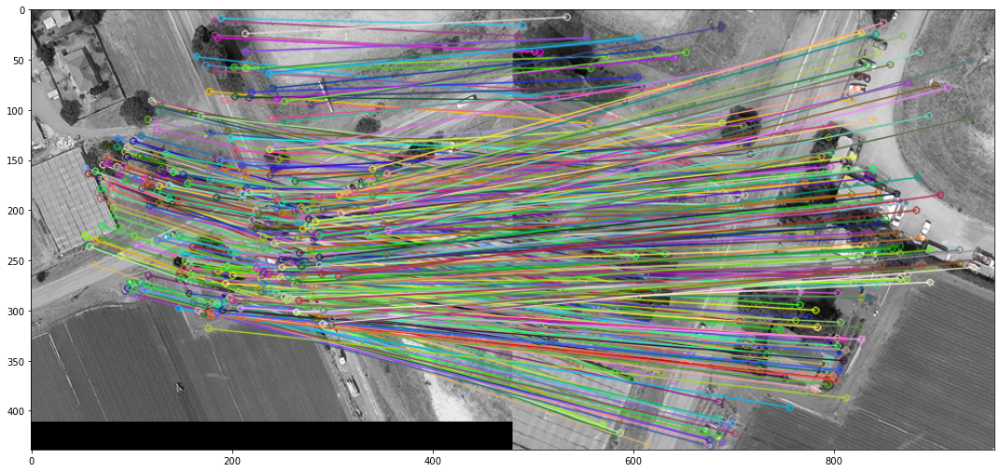

BUILD THE MOSAIC...


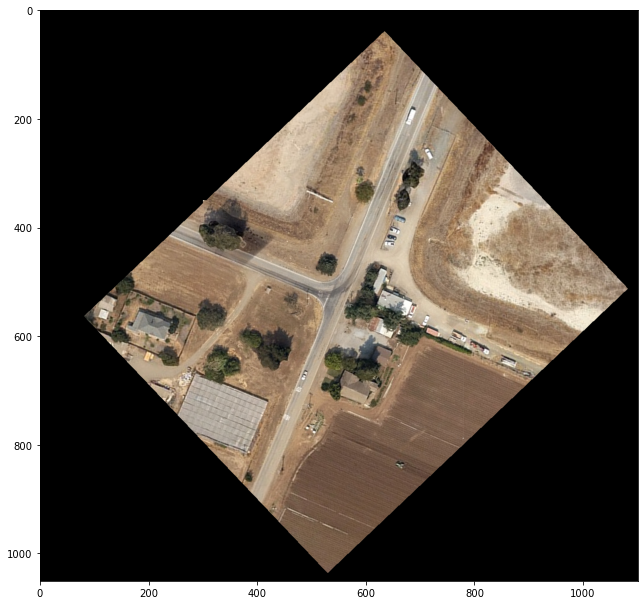

In [99]:
th = 10
max_it = 1000000
num_of_kp = 3000
path_images = 'Data/Satelite'
corners = [-300, 800, -350, 700] 
img_satelite = panorama(path_images, th , max_it, num_of_kp , corners, plot_matches = True)


COMPUTE THE IMAGE KEYPOINTS OF THE IMAGES...
MATCH THE KEYPOINTS...
COMPUTE THE HOMOGRAPIES...
Number of iterations: 18.190382371881316


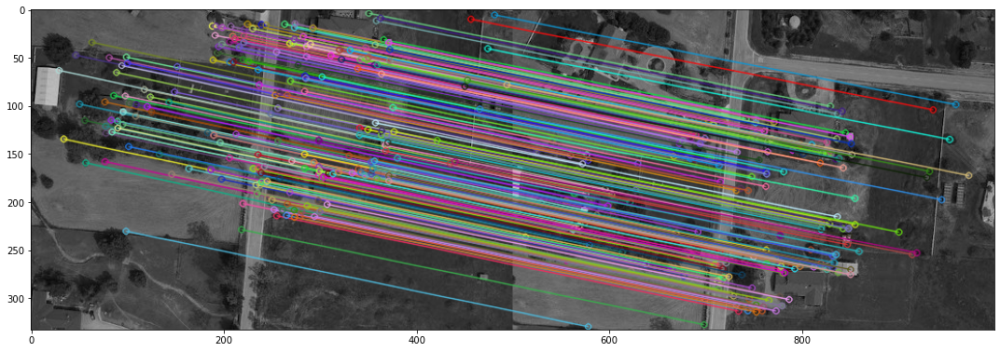

BUILD THE MOSAIC...


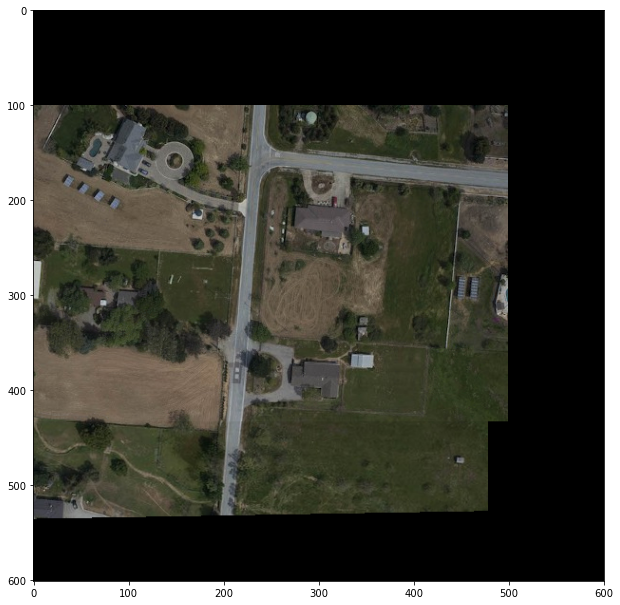

In [100]:
th = 10
max_it = 1000000
num_of_kp = 3000
path_images = 'Data/Satelite2'
corners = [0, 600, -100, 500] 
img_satelite2 = panorama(path_images, th , max_it, num_of_kp , corners, plot_matches = True)


<mark> <font size="3"> **Analization for images in Satelite and Satelite 2 folders** </mark>
<!-- d explain why it works or not in each case. In the scenarios that it does not work properly, suggest how you would try to improve the result obtained. -->
    
In both cases it works, besides that we can find great descriptors, since the algorithm use SIFT descriptors (which is invariant to rotation and scale), and even though there is a slighly change of rotation to the right, it is able to find a considerable number of descriptors and theirs correspondences, therefore it is expected that it works well.